## Setup

In [1]:
# this notebook is designed to run in conda environment 'wasp'
%run -i 'surfacedef2los.py'

# Pick which model you are using 
model = 'melgar_2023'
# Pick which scene and track you are using 
scene = 'f750_20220905-20230220' # scene = 's1_20230129-20230210_p21'
# Pick what data type you are using
type = 'los' # type = 'range_offsets', type = 'los'
# # Set the path to all of the grids
# tiffdir = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/'

## Set the corresponding field names
if model=='usgs_planar':
    disp_file = 'surface-displacement-files/surface_deformation_usgs_cutde_150_100.disp'
    print('Using the', model, 'model')
elif model=='melgar_2023':
    disp_file = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/surface-displacement-files/surface_deformation_melgar_combined_triangles.disp'
    print('Using the', model, 'model')
else:
    print('No matching model found')


Using the melgar_2023 model


## Get A2 A184 LOS observations

In [2]:
# Read in the observed 
# geotiff_file = "/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/usgs-isce-geotiffs/s1_20230129-20230210_p21_range.tif"
observation_file = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/los_ll.grd'

# Read it in as an xarray dataset
los_ds =  xr.load_dataset(observation_file)
# rename data variable to something unique
los_ds = los_ds.rename({'z':'los_mm'})
los_ds = los_ds.assign(los=lambda los_ds: los_ds.los_mm /1000)
los_ds

<xarray.Dataset>
Dimensions:  (lon: 4220, lat: 4470)
Coordinates:
  * lon      (lon) float64 34.33 34.33 34.34 34.34 ... 39.02 39.02 39.02 39.02
  * lat      (lat) float64 36.18 36.18 36.18 36.18 36.18 ... 39.9 39.9 39.9 39.9
Data variables:
    los_mm   (lat, lon) float32 nan nan nan nan nan nan ... nan nan nan nan nan
    los      (lat, lon) float32 nan nan nan nan nan nan ... nan nan nan nan nan
Attributes:
    Conventions:  CF-1.7
    title:        
    history:      gmt xyz2grd llpb -R34.3333333333/39.0222222222/36.175/39.9 ...
    description:  
    GMT_version:  6.4.0
    node_offset:  1

## Set Look Vectors

In [3]:
# Hard code the look vectors
look_e = -0.6372564476
look_n = -0.1192555537
look_u = 0.7610140142

## Get Modeled Data

In [7]:
# Read in Synthetic data
df = pd.read_csv(disp_file, sep='\t',header=0, names=['lon','lat', 'elev','disp_e','disp_n','disp_u'])
df = df.set_index(['lat', 'lon']) # set lat and lon to coordinates
modeled_disp = df.to_xarray() # convert it to an xarray dataset

# Interpolate the modeled data to match the sampling of observed data
interp_synth = modeled_disp.interp_like(los_ds)
# Merge to MEGADATA
mega_ds = xr.combine_by_coords([interp_synth,los_ds], join='outer')

## Project the model and get residual

In [8]:
# Project displacements into the LOS Look Vector
mod_proj = mega_ds.disp_e * look_e + mega_ds.disp_n * look_n + mega_ds.disp_u * look_u

# Calculate Residual 
mod_proj_residual = mega_ds.los - mod_proj

## Plot 3-panel Residual Figure

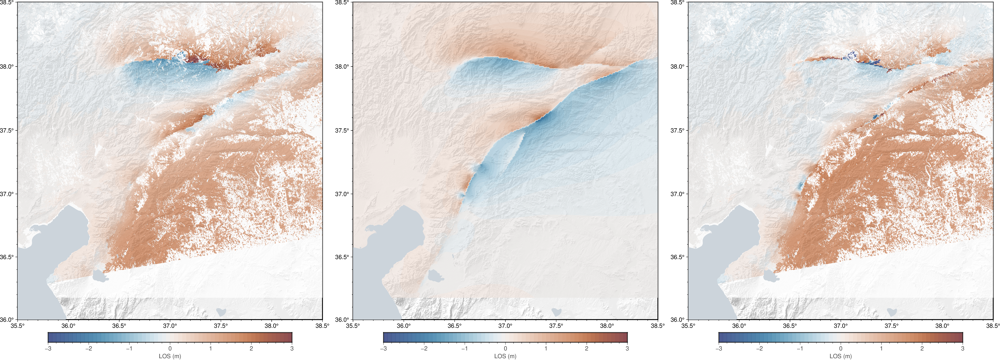

In [11]:
# Plot the residual 
obs_da = mega_ds.los
model_da = mod_proj
residual_da = mod_proj_residual
fig = residual_plot(obs_da, model_da, residual_da)
fig.show()
fig.savefig('plots/residual_figure_' + scene + '-' + type+'.jpg')

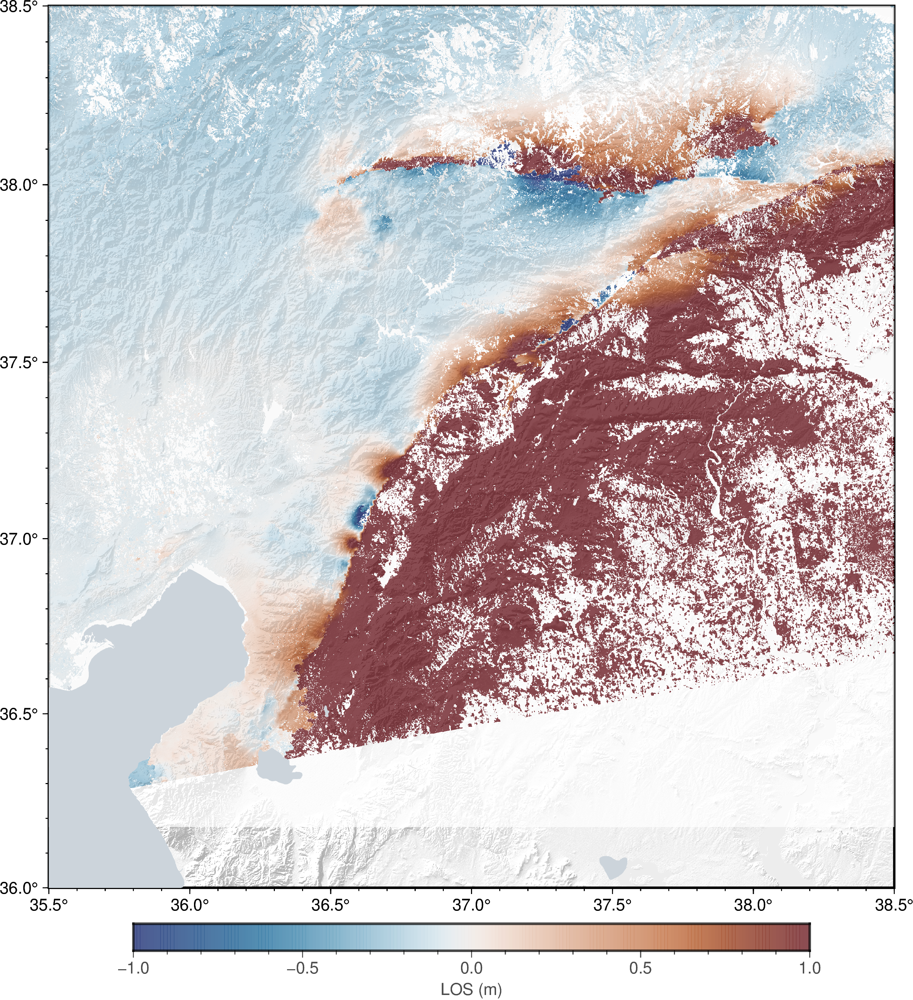

In [12]:
# Blow out the color scale
%run -i 'surfacedef2los.py'
# Plot the Residual
plt = plot_grd(mod_proj_residual, cpt=[-1, 1, 0.01])

plt.show()
plt.savefig('plots/residual_' + scene + '-' + type+'_cpt-altered.jpg')

## Plot the corresponding wrapped phase interferogram

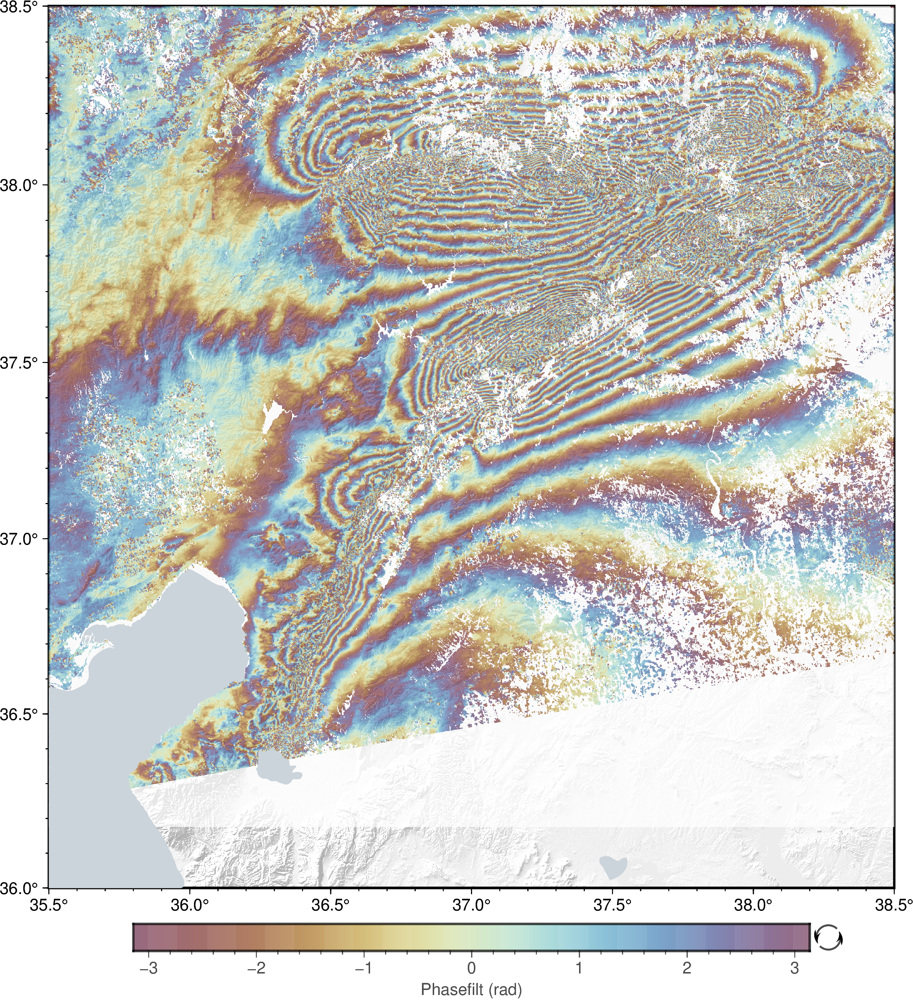

In [14]:
%run -i 'surfacedef2los.py'

grd = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/A2_A184_f750_20220905-20230220/phasefilt_ll.grd'
# Plot
fig = pygmt.Figure()
pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain", FONT="11p")
region = [35.5, 38.5, 36, 38.5]
projection = 'M0/0/20c'

# Plot hillshade
gradientgrd = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/topo/gradients.grd'
pygmt.makecpt(cmap="gray", series=[-2,0.1, 0.1])
fig.grdimage(region=region, projection=projection,grid=gradientgrd, cmap=True, nan_transparent=True)

pygmt.makecpt(cmap="romaO", series=[-3.14159,3.14159, 0.01])
fig.basemap(region=region, projection=projection, frame=["a0.5f0.1"])

fig.grdimage(
    grid=grd,
    projection=projection,
    cmap=True,
    transparency=30
)

fig.coast(shorelines=False, region=region, projection=projection, water='204/212/219')
fig.colorbar(frame="af+lPhasefilt (rad)",transparency=30)

fig.show()
fig.savefig('plots/' + scene + '_phasefilt.jpg')

## Calculate REGULAR LOS Cross section

In [15]:
# Calculate Cross section
region = [35.6,36.3,36.7, 37.2]

grid = mega_ds.los

# Choose a survey line
# a = [35.85, 37.1] #(lon, lat)
# b = [36, 36.8] #(lon, lat)
# Choose a survey line
a = [35.9, 37.1] #(lon, lat)
b = [36.05, 36.8] #(lon, lat)

# Generate points along a great circle corresponding to the survey line
# and store them in a pandas.DataFrame
track_df = pygmt.project(
    center=str(a[0]) + '/'+str(a[1]), # Start point of survey line (longitude/latitude)
    endpoint=str(b[0]) + '/'+str(b[1]),  # End point of survey line (longitude/latitude)
    generate="0.001",  # Output data in steps of 0.1 degrees
)

# Extract the elevation at the generated points from the downloaded grid
# and add it as new column "elevation" to the pandas.DataFrame
track_df = pygmt.grdtrack(
    grid=grid,
    points=track_df,
    newcolname="elevation",
)


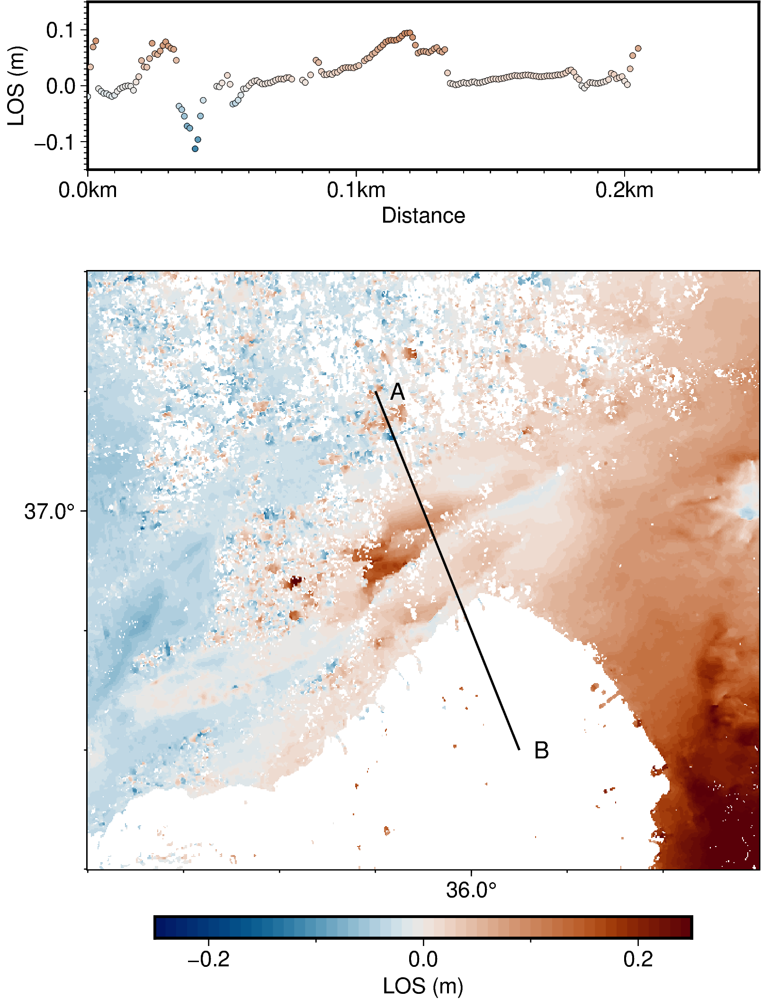

In [22]:
# Plot cross section 

# Set up main plot
fig = pygmt.Figure()
projection = 'M0/0/12c'
# ----------------------------------------------------------------------------
# Bottom: Map of elevation in study area
# ----------------------------------------------------------------------------

pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain", FONT="11p")
pygmt.makecpt(cmap="vik", series=[-.25, .25, 0.01])
fig.basemap(region=region, projection=projection, frame=["a0.5f0.1"])

# plot the grid
fig.grdimage(
    grid=grid,
    projection=projection,
    cmap=True,
)

# Plot the cross section line
fig.plot(
    y=[a[1],b[1]],  # Latitude in degrees North
    x=[a[0],b[0]],  # Longitude in degrees East
    pen="1p,black",
)

# Add labels "A" and "B" for the start and end points of the survey line
fig.text(
    y=[a[1],b[1]],  # Latitude in degrees North
    x=[a[0],b[0]],  # Longitude in degrees East
    text=["A", "B"],
    offset="0.4c/0c",  # Move text 0.9 centimeters to the right (x direction)
    font="12p,black",  # Use a font size of 15 points
)

# fig.coast(shorelines=False, region=region, projection=projection, water='204/212/219')
fig.colorbar(frame="af+lLOS (m)")

# ----------------------------------------------------------------------------
# Top: Elevation along survey line
# ----------------------------------------------------------------------------

# Shift plot origin 21 centimeters to the top
fig.shift_origin(yshift="12.5c")

fig.basemap(
    region=[0, .25, -.15, .15],  # x_min, x_max, y_min, y_max
    # Cartesian projection with a width of 12 centimeters and
    # a height of 3 centimeters
    projection="X12c/3c",
    # Add annotations ("a") and ticks ("f") as well as labels ("+l")
    # at the west or left and south or bottom sides ("WSrt")
    frame=["WSrt", "xa.1kf.01k+lDistance+ukm", "ya.1f.01+lLOS (m)"],
)

# Plot elevation along the survey line

fig.plot(
    x=track_df.p,
    y=track_df.elevation,
    cmap=True,
    fill=track_df.elevation,
    pen=".1p,black,solid",
    style="c3p",
)

fig.show()
fig.savefig('plots/mod_proj_los_cross-section.jpg')


## Calculate LOS RESIDUALCross section

In [23]:
# Calculate Cross section
region = [35.6,36.3,36.7, 37.2]

grid = mod_proj_residual

# Choose a survey line
# a = [35.85, 37.1] #(lon, lat)
# b = [36, 36.8] #(lon, lat)
# Choose a survey line
a = [35.9, 37.1] #(lon, lat)
b = [36.05, 36.8] #(lon, lat)

# Generate points along a great circle corresponding to the survey line
# and store them in a pandas.DataFrame
track_df = pygmt.project(
    center=str(a[0]) + '/'+str(a[1]), # Start point of survey line (longitude/latitude)
    endpoint=str(b[0]) + '/'+str(b[1]),  # End point of survey line (longitude/latitude)
    generate="0.001",  # Output data in steps of 0.1 degrees
)

# Extract the elevation at the generated points from the downloaded grid
# and add it as new column "elevation" to the pandas.DataFrame
track_df = pygmt.grdtrack(
    grid=grid,
    points=track_df,
    newcolname="elevation",
)


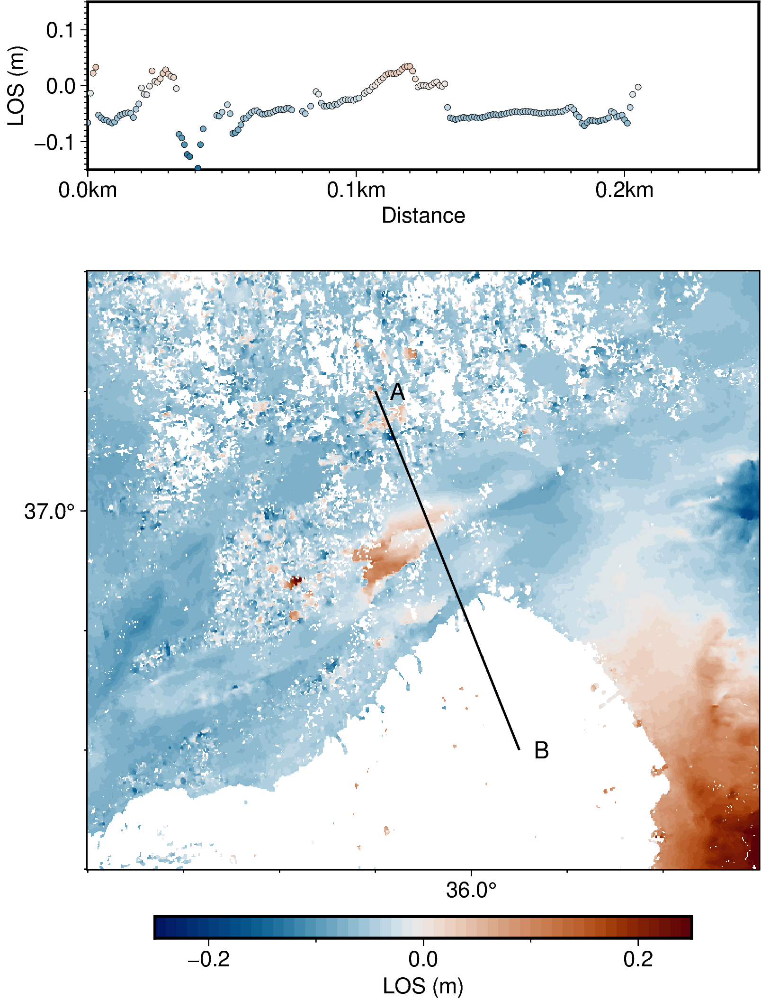

In [24]:
# Plot cross section 

# Set up main plot
fig = pygmt.Figure()
projection = 'M0/0/12c'
# ----------------------------------------------------------------------------
# Bottom: Map of elevation in study area
# ----------------------------------------------------------------------------

pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain", FONT="11p")
pygmt.makecpt(cmap="vik", series=[-.25, .25, 0.01])
fig.basemap(region=region, projection=projection, frame=["a0.5f0.1"])

# plot the grid
fig.grdimage(
    grid=grid,
    projection=projection,
    cmap=True,
)

# Plot the cross section line
fig.plot(
    y=[a[1],b[1]],  # Latitude in degrees North
    x=[a[0],b[0]],  # Longitude in degrees East
    pen="1p,black",
)

# Add labels "A" and "B" for the start and end points of the survey line
fig.text(
    y=[a[1],b[1]],  # Latitude in degrees North
    x=[a[0],b[0]],  # Longitude in degrees East
    text=["A", "B"],
    offset="0.4c/0c",  # Move text 0.9 centimeters to the right (x direction)
    font="12p,black",  # Use a font size of 15 points
)

# fig.coast(shorelines=False, region=region, projection=projection, water='204/212/219')
fig.colorbar(frame="af+lLOS (m)")

# ----------------------------------------------------------------------------
# Top: Elevation along survey line
# ----------------------------------------------------------------------------

# Shift plot origin 21 centimeters to the top
fig.shift_origin(yshift="12.5c")

fig.basemap(
    region=[0, .25, -.15, .15],  # x_min, x_max, y_min, y_max
    # Cartesian projection with a width of 12 centimeters and
    # a height of 3 centimeters
    projection="X12c/3c",
    # Add annotations ("a") and ticks ("f") as well as labels ("+l")
    # at the west or left and south or bottom sides ("WSrt")
    frame=["WSrt", "xa.1kf.01k+lDistance+ukm", "ya.1f.01+lLOS (m)"],
)

fig.plot(
    x=track_df.p,
    y=track_df.elevation,
    cmap=True,
    fill=track_df.elevation,
    pen=".1p,black,solid",
    style="c3p",
)

fig.show()
fig.savefig('plots/mod_proj_los-residual_cross-section.jpg')


## Phase cross section


In [28]:
# Calculate Cross section
region = [35.6,36.3,36.7, 37.2]
grid = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd'

# Choose a survey line
a = [35.9, 37.1] #(lon, lat)
b = [36.05, 36.8] #(lon, lat)

# Generate points along a great circle corresponding to the survey line
# and store them in a pandas.DataFrame
track_df = pygmt.project(
    center=str(a[0]) + '/'+str(a[1]), # Start point of survey line (longitude/latitude)
    endpoint=str(b[0]) + '/'+str(b[1]),  # End point of survey line (longitude/latitude)
    generate="0.001",  # Output data in steps of 0.1 degrees
)

# Extract the elevation at the generated points from the downloaded grid
# and add it as new column "elevation" to the pandas.DataFrame
track_df = pygmt.grdtrack(
    grid=grid,
    points=track_df,
    newcolname="elevation",
)


grdtrack [ERROR]: File /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd was not found
grdtrack [ERROR]: Cannot find file /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd
grdtrack [ERROR]: Must specify -G at least once


GMTCLibError: Module 'grdtrack' failed with status code 72:
grdtrack [ERROR]: File /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd was not found
grdtrack [ERROR]: Cannot find file /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd
grdtrack [ERROR]: Must specify -G at least once

In [29]:
# Plot cross section 

# Set up main plot
fig = pygmt.Figure()
projection = 'M0/0/12c'
# ----------------------------------------------------------------------------
# Bottom: Map of elevation in study area
# ----------------------------------------------------------------------------

pygmt.config(FORMAT_GEO_MAP="ddd.x", MAP_FRAME_TYPE="plain", FONT="11p")
pygmt.makecpt(cmap="romaO", series=[-3.14159,3.14159, 0.01])
fig.basemap(region=region, projection=projection, frame=["a0.5f0.1"])

# plot the grid
fig.grdimage(
    grid=grid,
    projection=projection,
    cmap=True,
)

# Plot the cross section line
fig.plot(
    y=[a[1],b[1]],  # Latitude in degrees North
    x=[a[0],b[0]],  # Longitude in degrees East
    pen="1p,black",
)

# Add labels "A" and "B" for the start and end points of the survey line
fig.text(
    y=[a[1],b[1]],  # Latitude in degrees North
    x=[a[0],b[0]],  # Longitude in degrees East
    text=["A", "B"],
    offset="0.4c/0c",  # Move text 0.9 centimeters to the right (x direction)
    font="12p,black",  # Use a font size of 15 points
)

# fig.coast(shorelines=False, region=region, projection=projection, water='204/212/219')
fig.colorbar(frame="af+lPhase (m)")

# ----------------------------------------------------------------------------
# Top: Elevation along survey line
# ----------------------------------------------------------------------------

# Shift plot origin 21 centimeters to the top
fig.shift_origin(yshift="12.5c")

fig.basemap(
    region=[0, .25, -3.2, 3.2],  # x_min, x_max, y_min, y_max
    # Cartesian projection with a width of 12 centimeters and
    # a height of 3 centimeters
    projection="X12c/3c",
    # Add annotations ("a") and ticks ("f") as well as labels ("+l")
    # at the west or left and south or bottom sides ("WSrt")
    frame=["WSrt", "xa.1kf.01k+lDistance+ukm", "ya1f.1+lPhase (rad)"],
)

# Plot elevation along the survey line
fig.plot(
    x=track_df.p,
    y=track_df.elevation,
    fill="black",
    pen="1p,black,solid",
    style="c1p",
)

# fig.plot( 
#     x = np.array([0, 7]),
#     y = np.array([9, 9])
# )
fig.show()
fig.savefig('plots/mod_proj_phase-residual_cross-section.jpg')


grdimage [ERROR]: File /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd was not found
grdimage [ERROR]: Cannot find file /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd


GMTCLibError: Module 'grdimage' failed with status code 72:
grdimage [ERROR]: File /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd was not found
grdimage [ERROR]: Cannot find file /Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/yin-gmtsar-grds/data/f750_20220905-20230220/phasefilt_ll.grd

## 3D render of aseismic slip

In [1]:
zrange = [-.25,.25]
region = [35.6,36.3,36.7,37.2,-.25,.25] # zmin/zmax are -.25,.25
grid = mod_proj_residual

fig = pygmt.Figure()

pygmt.makecpt(cmap="vik", series=[-.25, .25, 0.01])

fig.grdview(
    grid=grid,
    region=region,
    # Set the azimuth to -130 (230) degrees and the elevation to 30 degrees
    perspective=[160, 30],
    frame=["xaf", "yaf", "WSnE"],
    projection="M15c",
    zsize="2c",
    surftype="s",
    cmap=True,
    plane="-0.25+ggrey",
    # Set the contour pen thickness to "0.1p"
    contourpen="0.1p",
)
fig.colorbar(perspective=True, frame=["a.1f.02", "x+lElevation", "y+lm"])
fig.show()
fig.savefig('plots/3d-alos2-residual.jpg')

NameError: name 'a2_a184_mod_proj_residual' is not defined

## Older Stuff

In [ ]:
# # Get a mean look vector 
# los_look = (np.nanmean(look_ds.los_e), np.nanmean(look_ds.los_n), np.nanmean(look_ds.los_u))# e, n, u
# print('Average Line-of-Sight look vector (e, n, u): ',los_look)

# az_look = (np.nanmean(look_ds.az_e), np.nanmean(look_ds.az_n), np.nanmean(look_ds.az_u))# e, n, u
# print('Average Azimuth offset look vector (e, n, u): ', az_look)

In [ ]:
# # Project the surface deformations into the line of sight (look)
# df = pd.read_csv(disp_file, sep='\t',header=0, names=['lon','lat', 'elev','disp_e','disp_n','disp_u']) # read in as pandas dataframe
# modeled_disp = df.to_xarray() # convert dataframe to xarray data array
# modeled_disp = modeled_disp.set_coords(("lat", "lon")) # set lon and lat as coordinates
# modeled_disp

In [ ]:
# # Downsample Look vector data to match modeled data
# looks_downsamp = look_ds.interp_like(modeled_disp)
# looks_downsamp = looks_downsamp.dropna(dim='index')
# looks_downsamp

In [ ]:
# # Use xarrays to do a left join of the two datasets
# # This combines them, keeping the modeled displacement courser smpling,
# # and filling in NaNs for any coordinates where modeled data doesn't exist
# ds_merge = xr.combine_by_coords([modeled_disp,looks_downsamp], join='left')
# ds_merge

In [ ]:
# IMPlement as a fucntion 
# Project the surface deformations into the line of sight (look)

# %run -i 'surfacedef2los.py'  #update the function code
# ds = surfacedef2los(disp_file,look)
# ds

In [ ]:
# Plot the projected LOS 
# Create a data array with the los field
los_da = ds.los
fig = plot_grd(los_da)
fig.show()
fig.savefig('plots/modeled_disp_'+model+'_los_projected.jpg', dpi=720)

In [ ]:
## Use USGS downsampled D021 Range and azimuth offset text files

# # set the file directories depending on the model chosen
# if type == 'azimuth_offsets':
#     obs_disp = pd.read_csv('observation-files/s1_20230129-20230210_p21_azimuth.txt', sep='\t',header=0, names=['lon','lat','disp','sx','sy','sz'])
# elif type == 'range_offsets':
#     obs_disp = pd.read_csv('observation-files/s1_20230129-20230210_p21_range.txt', sep='\t',header=0, names=['lon','lat','disp','sx','sy','sz'])
# else:print('No data for that data type')

# # Read in look vectors 
# obs_disp = pd.read_csv('observation-files/s1_20230129-20230210_p21_azimuth.txt', sep='\t',header=0, names=['lon','lat','disp','sx','sy','sz'])
# # Calculate average look vectors for Path D021, Azimuth offsets
# e = np.mean(obs_disp['sx']) # east component of avg look vector (single number)
# n = np.mean(obs_disp['sy']) # north component of avg look vector (single number)
# u = np.mean(obs_disp['sz']) # up component of avg look vector (single number)
# look = (e, n, u)
# print('Average look vector for Azimuth offsets (e, n, u): ',look)

# obs_disp = pd.read_csv('observation-files/s1_20230129-20230210_p21_range.txt', sep='\t',header=0, names=['lon','lat','disp','sx','sy','sz'])
# # Calculate average look vectors for Path D021, Range offsets
# e = np.mean(obs_disp['sx']) # east component of avg look vector (single number)
# n = np.mean(obs_disp['sy']) # north component of avg look vector (single number)
# u = np.mean(obs_disp['sz']) # up component of avg look vector (single number)
# look = (e, n, u)
# print('Average look vector for Range offsets (e, n, u): ',look)

In [ ]:
# Plot modeled surface deformations as a single plot w/ 3 subplots
%run -i 'surfacedef2los.py'
surfacedefplot(disp_file)

# rename output modeled_los.jpg to 'modeled_'+model+'_los_vertical.jpg'
os.rename('modeled_disp.jpg','plots/modeled_disp_'+model+'_enu.jpg')